In [15]:
import sqlite3
import os
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.preprocessing import StandardScaler

conn = sqlite3.connect('FPA_FOD_20170508.sqlite')
cursor = conn.cursor()

column_names = ['FIRE_SIZE', 'LATITUDE', 'LONGITUDE', 'STATE']
select_columns = ', '.join(column_names)
sql_query = sql_query = f"SELECT {select_columns} FROM Fires"

cursor.execute(sql_query)
data = cursor.fetchall()
df = pd.DataFrame(data, columns=column_names)

conn.close()

In [16]:
df["FIRE_SIZE"] = StandardScaler().fit_transform(df[["FIRE_SIZE"]])
df.dropna()
df.size

7521860

In [26]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

states = ['AK', 'AL', 'AR', 'AZ', 'CA', 'CO', 'CT', 'DC', 'DE', 'FL', 'GA', 'HI', 'IA', 'ID', 'IL', 'IN', 'KS', 'KY', 'LA', 'MA', 'MD', 'ME', 'MI', 'MN', 'MO', 'MS', 'MT', 'NC', 'ND', 'NE', 'NH', 'NJ', 'NM', 'NV', 'NY', 'OH', 'OK', 'OR', 'PA', 'PR', 'RI', 'SC', 'SD', 'TN', 'TX', 'UT', 'VA', 'VT', 'WA', 'WI', 'WV', 'WY']
elbow = []

for state in states:
    temp = df.loc[df['STATE'] == state]
    temp = temp.drop(columns=['STATE'], axis = 1)
    sil_score_max = -1
    for n_clusters in range(2,10):
      model = KMeans(n_clusters = n_clusters, init='k-means++', max_iter=100, n_init=1)
      labels = model.fit_predict(temp)
      sil_score = silhouette_score(temp, labels)
      if sil_score > sil_score_max:
        sil_score_max = sil_score
        best_n_clusters = n_clusters
    elbow.append(best_n_clusters)
print(elbow)
    

[2, 2, 2, 9, 2, 3, 2, 2, 3, 2, 2, 4, 2, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 4, 2, 2, 3, 3, 5, 3, 3, 4, 2, 2, 2, 4, 2, 9, 2, 3, 4, 2, 3, 2, 3, 2, 2]


In [109]:
#prev code sets elbow to the following but takes ~4 hours to finish 
#elbow = [2, 2, 2, 9, 2, 3, 2, 2, 3, 2, 2, 4, 2, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 4, 2, 2, 3, 3, 5, 3, 3, 4, 2, 2, 2, 4, 2, 9, 2, 3, 4, 2, 3, 2, 3, 2, 2]
total = 0
for val in elbow:
    total += val
print(total/len(elbow))

2.769230769230769


C:\Program Files\Python39\lib\site-packages\pandas\plotting\_matplotlib\core.py:509: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = self.plt.figure(figsize=self.figsize)


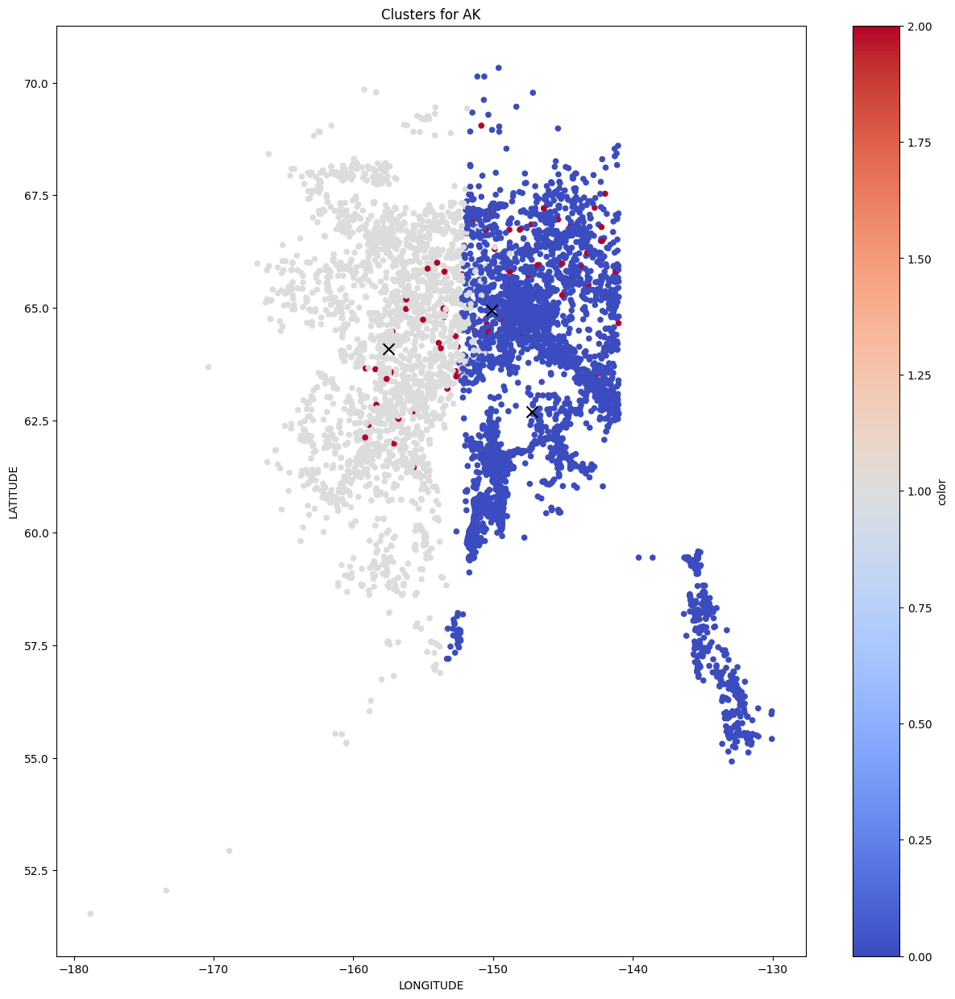

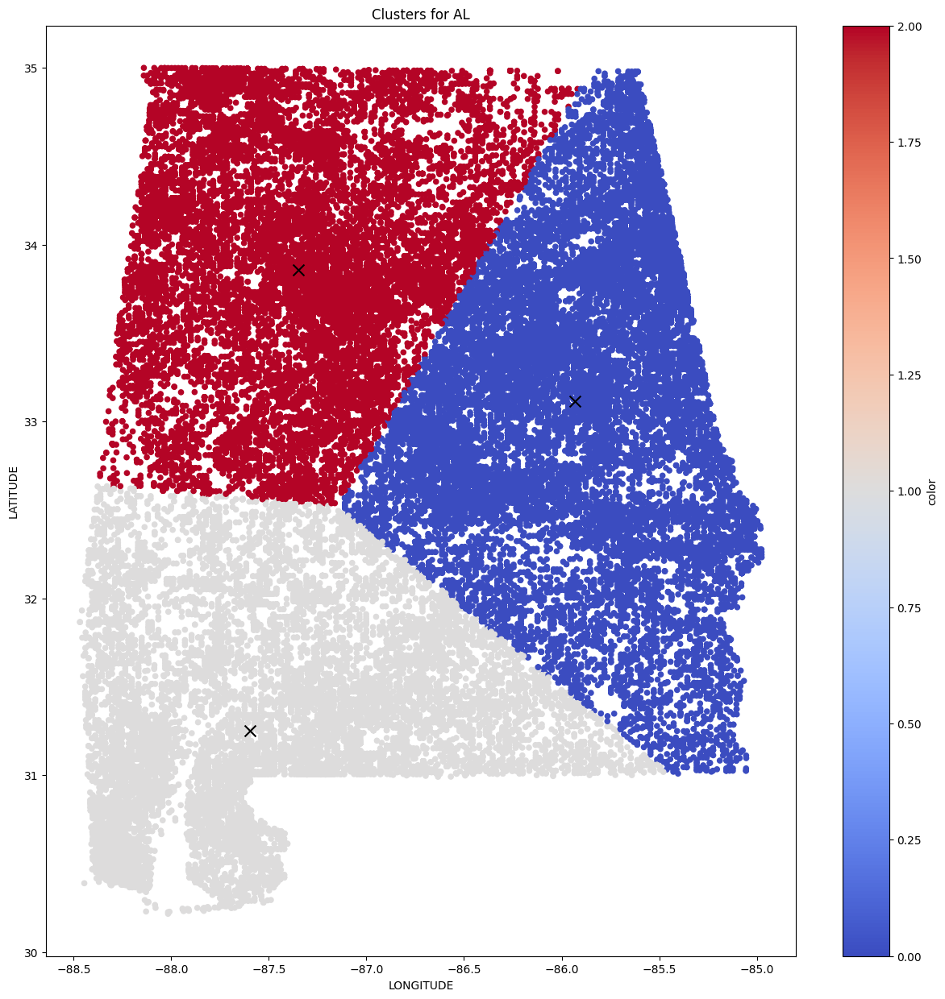

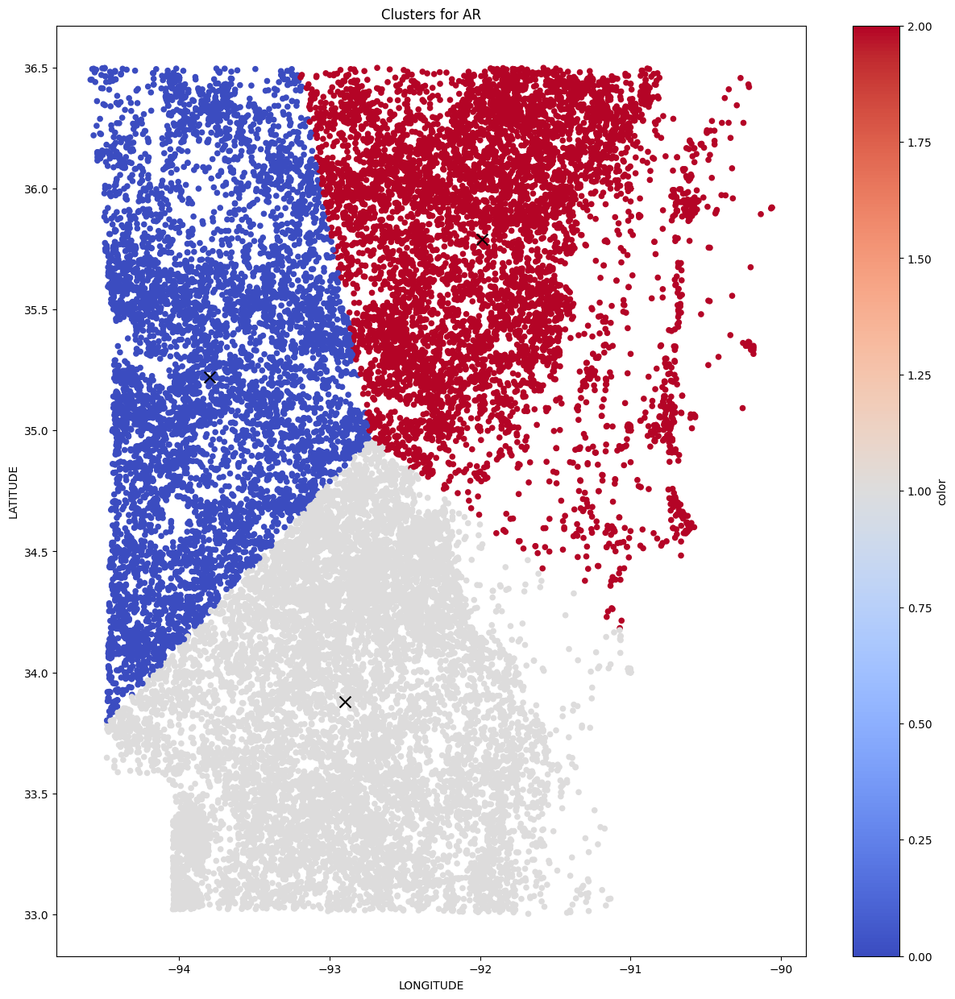

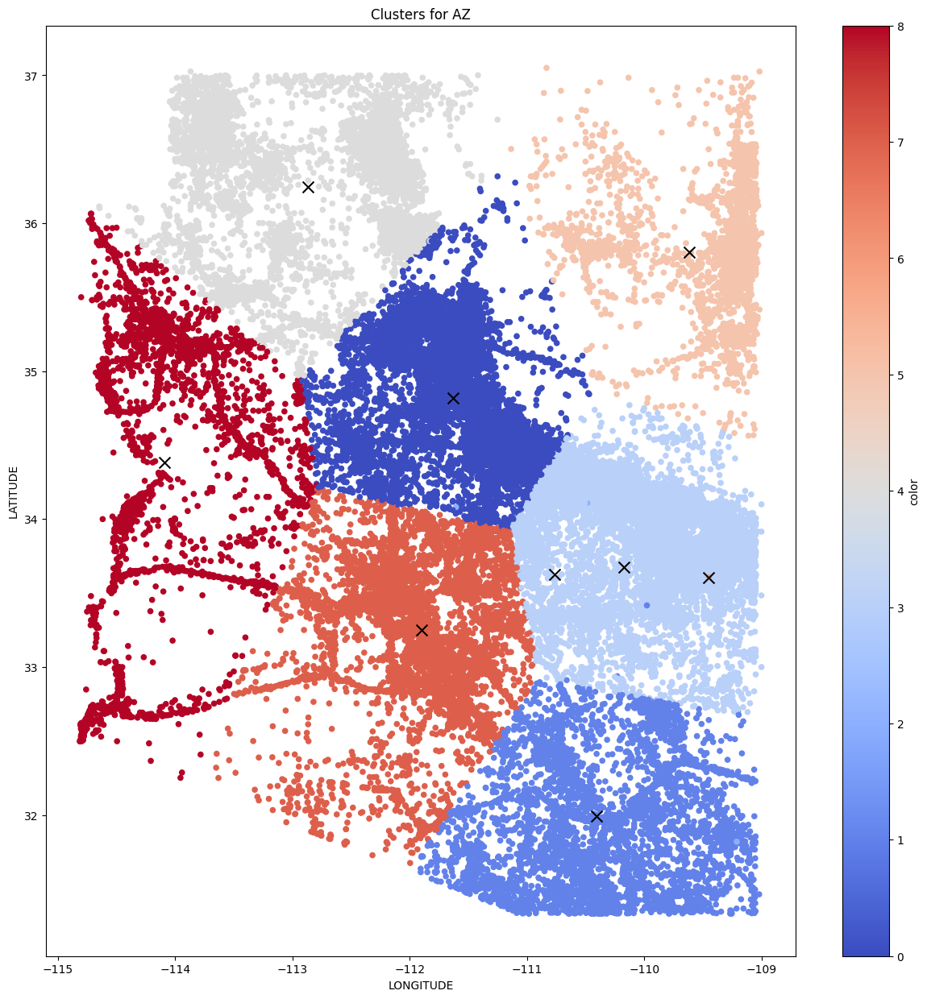

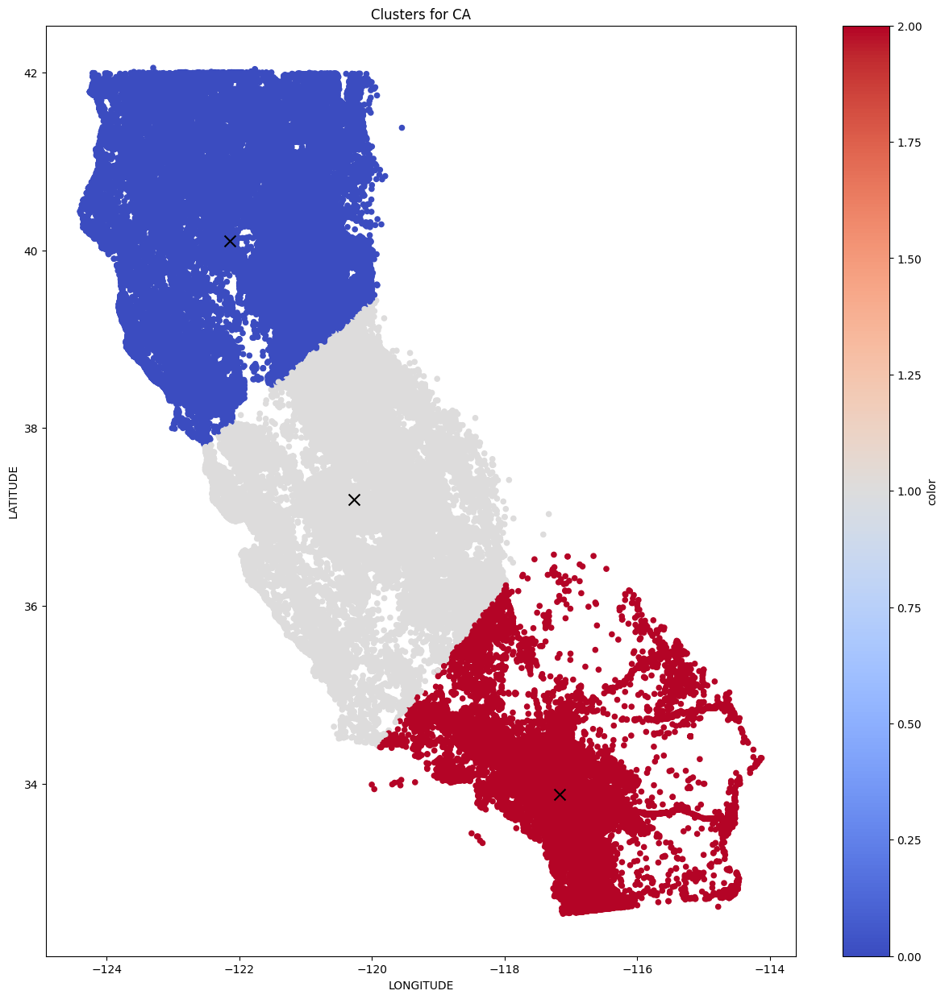

...

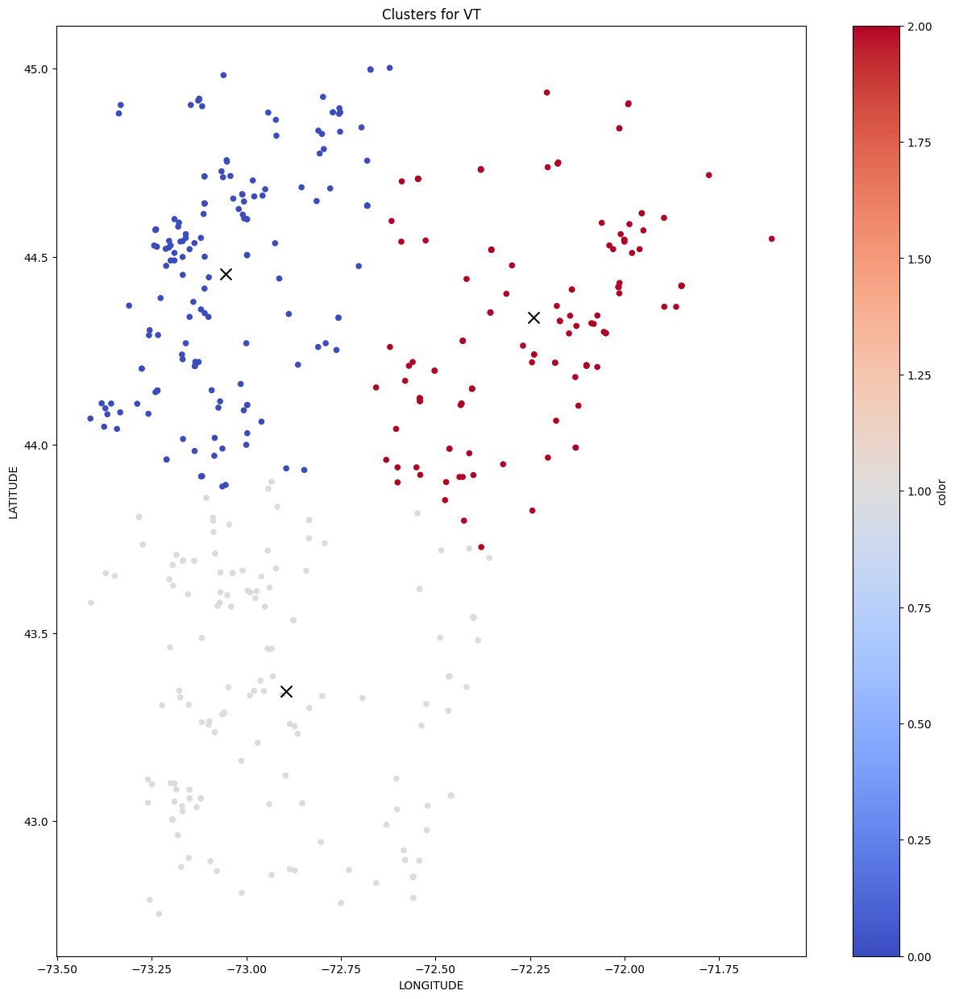

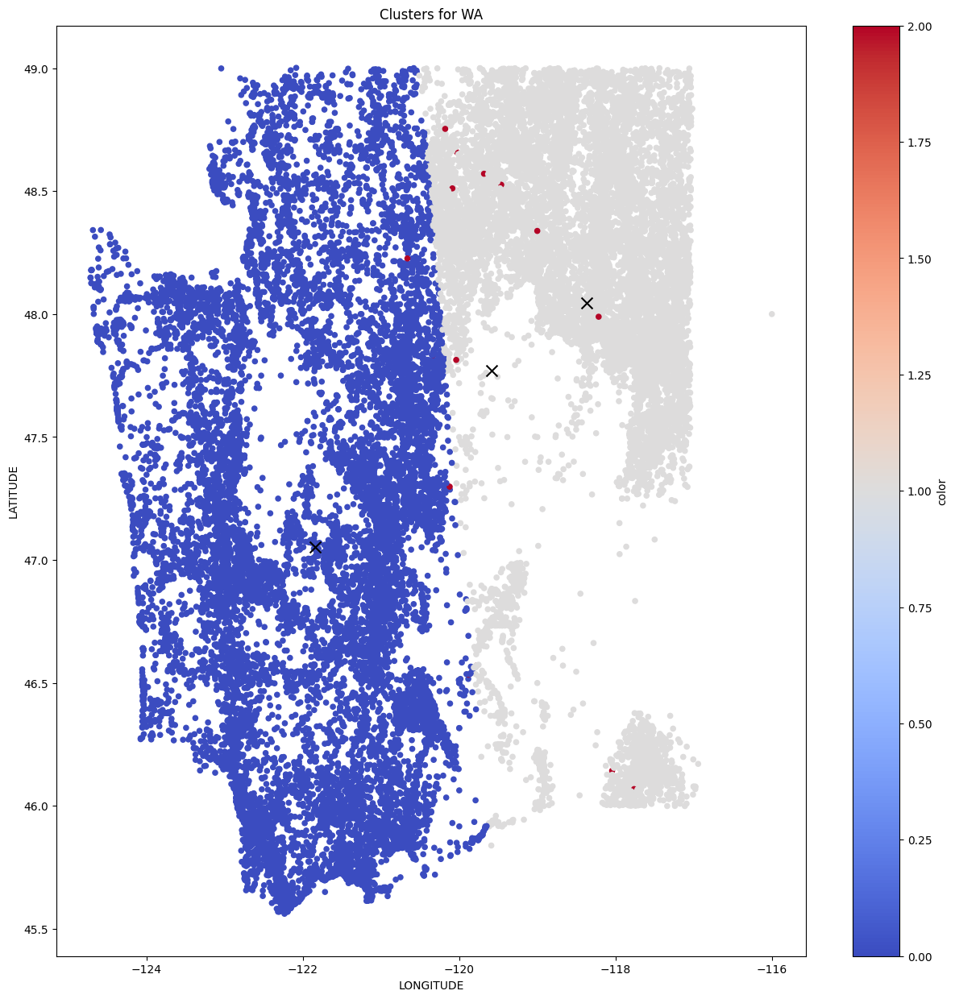

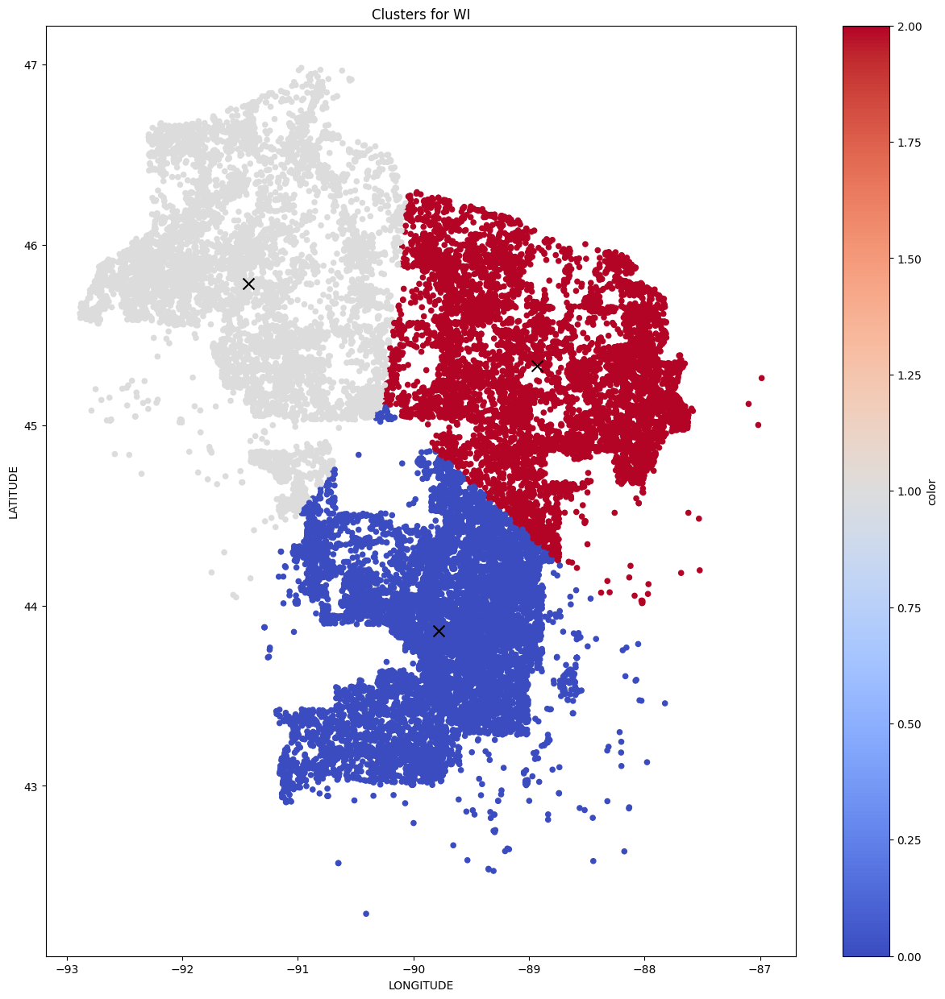

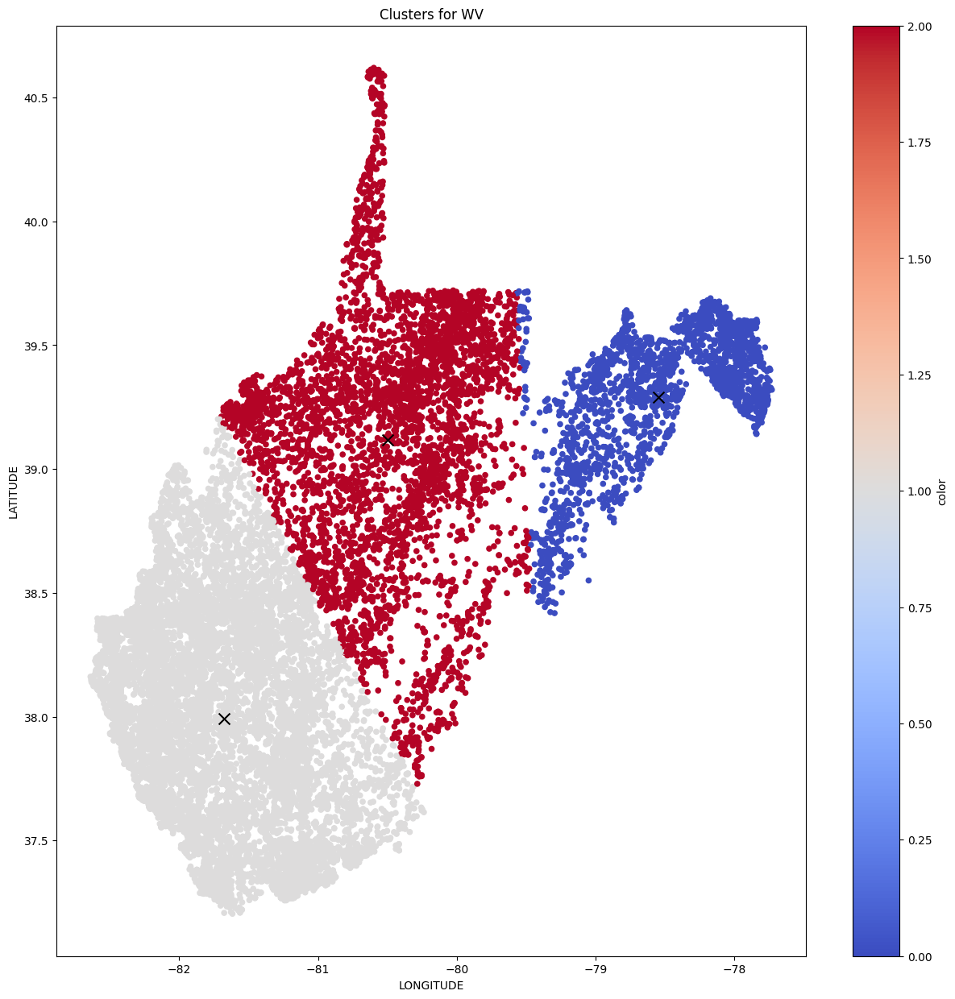

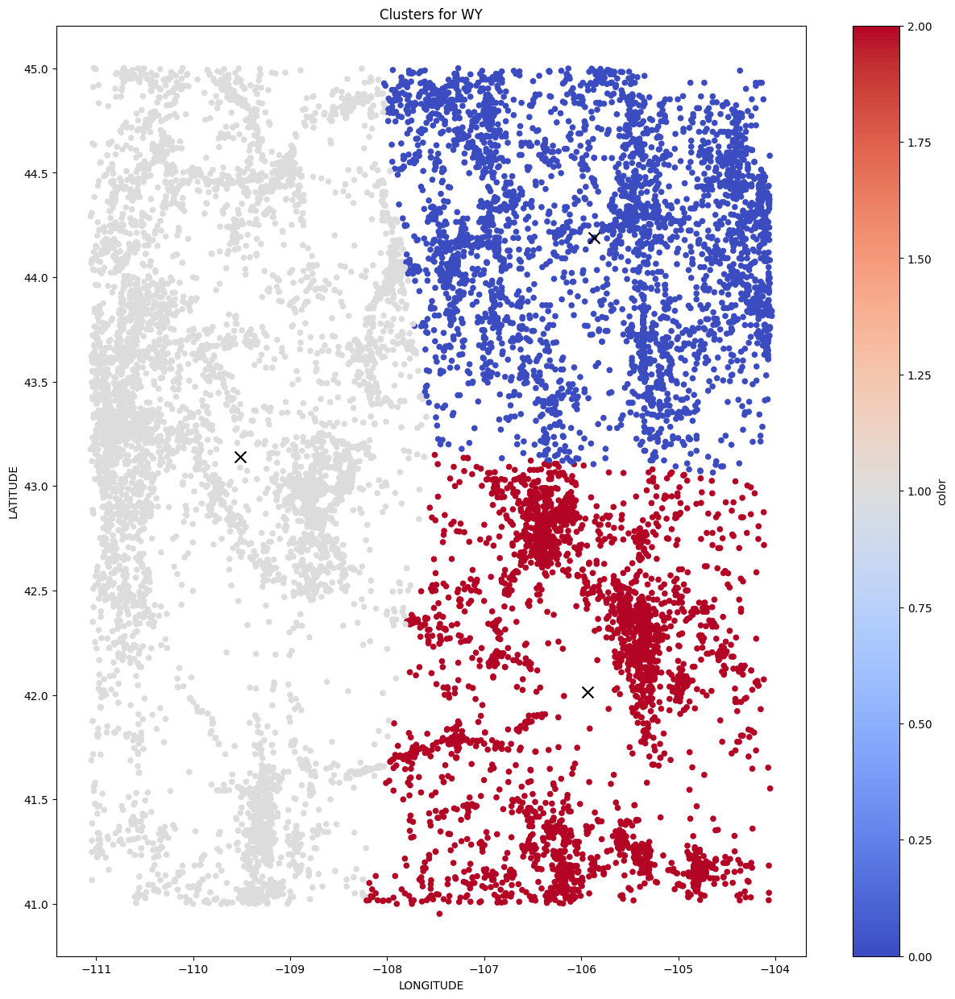

In [127]:
for state in states:
    cluster_num = 3
    suggested_num = elbow[states.index(state)]
    if suggested_num > cluster_num:
        cluster_num = suggested_num
    kmeans = KMeans(n_clusters=cluster_num, init ='k-means++', max_iter=300, n_init=10,random_state=0)
    temp = df.loc[df['STATE'] == state]
    temp = temp.drop(columns=['STATE'], axis = 1)
    label = kmeans.fit_predict(temp)
    cluster_assignments = kmeans.labels_
    centroids = kmeans.cluster_centers_
    temp['color'] = cluster_assignments
    temp.plot.scatter('LONGITUDE', 'LATITUDE', c='color', colormap='coolwarm', figsize=(15, 15))
    for centroid in centroids:
        plt.scatter(centroid[2], centroid[1], c='black', s=100, marker='x')
    plt.title("Clusters for " + state)
